In [3]:
import pandas as pd
import numpy as np
import os
import sys
from time import time
from astropy.table import Table
from astropy.io import fits
from astropy import units as u
from astropy import constants 
from astropy.coordinates import SkyCoord
from astropy.visualization import hist
from astroML.datasets import fetch_imaging_sample, fetch_sdss_S82standards
from astroML.crossmatch import crossmatch_angular

In [4]:
from scipy.stats.stats import pearsonr
from scipy.stats import spearmanr#

import matplotlib as mpl
import matplotlib.pyplot as plt
from pylab import cm

from collections import OrderedDict
from adjustText import adjust_text

%matplotlib inline
%config InlineBackend.figure_format='svg'
# Edit the font, font size, and axes width
mpl.rcParams['font.family'] = 'Avenir'
plt.rcParams['font.size'] = 18
plt.rcParams['axes.linewidth'] = 2

/var/folders/jp/4mwsn7_x6j9gnv1hl1dztqth0000gn/T/ipykernel_13010/1180453565.py:1: DeprecationWarning: Please use `pearsonr` from the `scipy.stats` namespace, the `scipy.stats.stats` namespace is deprecated.
  from scipy.stats.stats import pearsonr


In [5]:
#from adjustText import adjust_text
import matplotlib as mpl
def set_ax_tick(ax):
    ax.xaxis.set_tick_params(which='major', size=10, width=2, direction='in', top='on',)
    ax.xaxis.set_tick_params(which='minor', size=5, width=2, direction='in', top='on')
    ax.yaxis.set_tick_params(which='major', size=10, width=2, direction='in', right='on')
    ax.yaxis.set_tick_params(which='minor', size=5, width=2, direction='in', right='on')

def set_ax_locator(ax,xma=1,xmi=0.2,yma=1,ymi=0.2):
    ax.xaxis.set_major_locator(mpl.ticker.MultipleLocator(xma))
    ax.xaxis.set_minor_locator(mpl.ticker.MultipleLocator(xmi))
    ax.yaxis.set_major_locator(mpl.ticker.MultipleLocator(yma))
    ax.yaxis.set_minor_locator(mpl.ticker.MultipleLocator(ymi)) 

In [6]:
from astropy.cosmology import FlatLambdaCDM,Planck13,Planck15,z_at_value
from astropy import units as u
from astropy.cosmology import LambdaCDM
cosmo = LambdaCDM(H0=70, Om0=0.3, Ode0=0.7)
#cosmo=FlatLambdaCDM(H0=73,Om0=0.3)

In [7]:
def drop_index(data):
    data=data.reset_index(drop=True)
    return data

In [ ]:
https://johannesbuchner.github.io/UltraNest/example-line.html

# Tutorial fitting a line

In [ ]:
import numpy as np
# Black hole data from Kormendy & Ho (2014) https://arxiv.org/abs/1304.7762 https://arxiv.org/abs/1308.6483
# Bulge mass and error (log Msun)
mB = np.array([9.05, 11.84, 11.27, 10.65, 11.5, 11.74, 11.33, 10.26, 11.06, 11.61, 10.5, 10.91, 11.26, 11.01, 11.77, 11.65, 10.85, 11.62, 11.51, 10.88, 11.84, 10.85, 11.72, 9.64, 11.64, 10.97, 11.16, 12.09, 11.28, 11.05, 11.65, 11.6, 11.0, 10.57, 11.69, 11.25, 11.61, 11.65, 11.75, 11.6, 11.81, 11.78])
mBerr = np.array([0.1, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.1, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.1, 0.09, 0.09, 0.09, 0.1, 0.09])
# Black hole mass, errors, and magnitude
mBH = np.log10([2.45e+06, 1.69e+08, 1.47e+09, 5.90e+08, 8.81e+08, 4.65e+09, 3.87e+09,
 1.45e+07, 1.08e+07, 3.72e+09, 1.78e+08, 4.16e+08, 1.37e+08, 4.65e+08,
 9.09e+09, 5.29e+08, 9.78e+08, 9.25e+08, 1.30e+07, 6.96e+07, 2.54e+09,
 9.00e+07, 6.15e+09, 6.00e+08, 4.72e+09, 2.02e+08, 1.71e+09, 2.08e+10,
 8.55e+08, 5.69e+07, 4.75e+09, 3.69e+09, 2.73e+08, 4.87e+08, 3.74e+09,
 2.10e+09, 3.96e+08, 2.30e+09, 1.34e+09, 2.48e+09, 3.74e+09, 1.30e+09])
mBHlo = np.log10([1.43e+06, 1.39e+08, 1.27e+09, 5.39e+08, 4.35e+08, 4.24e+09, 3.16e+09,
 0.10e+07, 1.03e+07, 3.21e+09, 8.50e+07, 3.12e+08, 9.00e+07, 3.66e+08,
 6.28e+09, 4.21e+08, 6.70e+08, 8.38e+08, 0.10e+07, 5.62e+07, 2.44e+09,
 4.50e+07, 5.78e+09, 4.00e+08, 3.67e+09, 1.52e+08, 1.52e+09, 4.90e+09,
 4.07e+08, 4.65e+07, 2.81e+09, 2.65e+09, 1.94e+08, 3.34e+08, 2.59e+09,
 2.00e+09, 2.40e+08, 2.19e+09, 9.30e+08, 2.29e+09, 3.22e+09, 1.11e+09])
mBHhi = np.log10([3.460e+06, 1.970e+08, 1.680e+09, 6.510e+08, 1.781e+09, 5.380e+09,
 4.480e+09, 2.910e+07, 1.120e+07, 3.830e+09, 2.720e+08, 5.200e+08,
 1.820e+08, 5.640e+08, 1.143e+10, 6.360e+08, 1.286e+09, 1.023e+09,
 2.240e+08, 8.290e+07, 3.120e+09, 1.350e+08, 6.530e+09, 9.000e+08,
 5.760e+09, 2.530e+08, 1.810e+09, 3.660e+10, 1.293e+09, 6.730e+07,
 5.630e+09, 3.790e+09, 3.410e+08, 6.400e+08, 5.500e+09, 2.730e+09,
 6.720e+08, 3.450e+09, 1.850e+09, 2.960e+09, 4.160e+09, 1.500e+09])

# Velocity dispersion and error (km/s)
sigma = np.array([77.0, 226.0, 328.0, 167.0, 315.0, 276.0, 270.0, 175.0, 166.0, 297.0, 145.0, 206.0, 229.0, 182.0, 270.0, 315.0, 242.0, 296.0, 182.0, 167.0, 300.0, 190.0, 324.0, 185.0, 380.0, 177.0, 355.0, 347.0, 222.0, 150.0, 333.0, 328.0, 183.0, 239.0, 318.0, 389.0, 266.0, 292.0, 257.0, 331.0, 288.0, 322.0])
sigmaerr = np.array([3.0, 9.0, 9.0, 3.0, 3.0, 2.0, 10.0, 8.0, 16.0, 12.0, 7.0, 10.0, 11.0, 9.0, 27.0, 15.0, 12.0, 14.0, 5.0, 8.0, 7.0, 9.0, 28.0, 9.0, 19.0, 8.0, 14.0, 5.0, 11.0, 7.0, 2.0, 11.0, 9.0, 11.0, 2.0, 3.0, 13.0, 5.0, 26.0, 5.0, 14.0, 16.0])

n_data = len(mBerr)

## Bulge velocity

In [ ]:
%matplotlib inline
import matplotlib.pyplot as plt
plt.figure()
xlabel = 'Bulge mass [log, $M_\odot$]'
ylabel = 'Velocity dispersion [km/s]'
plt.xlabel(xlabel)
plt.ylabel(ylabel)
plt.errorbar(x=mB, xerr=mBerr, y=sigma, yerr=sigmaerr,
             marker='o', ls=' ', color='orange')
plt.yscale('log')

In [ ]:
samples = []

plt.figure()
for i in range(n_data):
    # draw normal random points

    # scale according to error bars and values
    samples_mBi = np.random.normal(mB[i], mBerr[i], size=400)

    # same for sigma
    samples_sigmai = np.random.normal(sigma[i], sigmaerr[i], size=400)

    # we will work in log-sigma:
    samples_logsigmai = np.log10(samples_sigmai)

    samples.append([samples_mBi, samples_logsigmai])

    # for each galaxy, plot alittle cloud with its own colors
    plt.scatter(samples_mBi, samples_logsigmai, s=2, marker='x')

samples = np.array(samples)
xlabel = 'Bulge mass [log, $M_\odot$]'
ylabel = 'Velocity dispersion [log, km/s]'
plt.xlabel(xlabel)
plt.ylabel(ylabel)

In [ ]:
samples.shape

In [ ]:
parameters = ['slope', 'offset', 'scatter']

def prior_transform(cube):
    # the argument, cube, consists of values from 0 to 1
    # we have to convert them to physical scales

    params = cube.copy()
    # let slope go from -3 to +3
    lo = -3
    hi = +3
    params[0] = cube[0] * (hi - lo) + lo
    # let offset go from 10 to 1000 km/s -- use log
    lo = np.log10(10)
    hi = np.log10(1000)
    params[1] = cube[1] * (hi - lo) + lo
    # let scatter go from 0.001 to 10
    lo = np.log10(0.001)
    hi = np.log10(10)
    params[2] = 10**(cube[2] * (hi - lo) + lo)
    return params

In [ ]:
import scipy.stats

def log_likelihood(params):
    # unpack the current parameters:
    slope, offset, scatter = params

    # compute for each x point, where it should lie in y
    y_expected = (samples[:,0] - 10) * slope + offset
    # compute the probability of each sample
    probs_samples = scipy.stats.norm(y_expected, scatter).pdf(samples[:,1])
    # average over each galaxy, because we assume one of the points is the correct one (logical OR)
    probs_objects = probs_samples.mean(axis=1)
    assert len(probs_objects) == n_data
    # multiply over the galaxies, because we assume our model holds true for all objects (logical AND)
    # for numerical stability, we work in log and avoid zeros
    loglike = np.log(probs_objects + 1e-100).sum()
    return loglike

In [ ]:
import ultranest

sampler = ultranest.ReactiveNestedSampler(parameters, log_likelihood, prior_transform)

In [ ]:
result = sampler.run(min_num_live_points=50, min_ess=100) # you can increase these numbers later

In [ ]:
from ultranest.plot import cornerplot
cornerplot(sampler.results)

In [ ]:
plt.figure()
plt.xlabel(xlabel)
plt.ylabel(ylabel)
plt.errorbar(x=mB, xerr=mBerr, y=sigma, yerr=sigmaerr,
             marker='o', ls=' ', color='orange')

from ultranest.plot import PredictionBand
x = np.linspace(9, 12.5, 400)
band = PredictionBand(x)
band_lo = PredictionBand(x)
band_hi = PredictionBand(x)

for params in sampler.results['samples'][:40]:
    slope, offset, scatter = params
    y = (x - 10) * slope + offset
    band.add(10**y)

    # indicate intrinsic scatter
    band_hi.add(10**(y + scatter))
    band_lo.add(10**(y - scatter))

band.shade(color='k', alpha=0.1)
band.line(color='k')
band_lo.line(color='r', ls='--')
band_hi.line(color='r', ls='--')

plt.yscale('log');


In [ ]:
scatter_samples = result['weighted_samples']['points'][:,2]
weights = result['weighted_samples']['weights']

plt.figure(figsize=(8, 2.5))

bins=np.linspace(0.01, 0.2, 100)
plt.hist(scatter_samples, weights=weights, bins=bins, density=True, histtype='step')

plt.xlabel('sigma')
plt.ylabel("Posterior probability")


In [ ]:
result['weighted_samples']['bootstrapped_weights'].shape

In [ ]:
from fastkde import fastKDE

In [ ]:
plt.figure()
bins=np.linspace(0.01, 0.2, 64+1)
scatter_samples = result['samples'][:,2]

pdf, _ = fastKDE.pdf(scatter_samples, axes=(bins,))
plt.plot(bins, pdf, color='k')

from ultranest.plot import PredictionBand
from ultranest.integrator import resample_equal
band = PredictionBand(bins)

for weights in result['weighted_samples']['bootstrapped_weights'].transpose():
    scatter_samples = resample_equal(result['weighted_samples']['points'][:,2], weights)
    pdf, _ = fastKDE.pdf(scatter_samples, axes=(bins,))
    band.add(pdf)

band.line(ls='--', color='r', alpha=0.5)
band.shade(0.49, color='r', alpha=0.1)


plt.xlabel('$\sigma$')
plt.ylabel("Posterior probability")
#plt.yscale('log')
plt.ylim(1e-3, 50);

In [ ]:
parameters0 = ['offset', 'scatter']

def prior_transform0(cube):
    params = cube.copy()
    # let offset go from 10 to 1000 km/s -- use log
    lo = np.log10(10)
    hi = np.log10(1000)
    params[0] = cube[0] * (hi - lo) + lo
    # let scatter go from 0.001 to 10
    lo = np.log10(0.001)
    hi = np.log10(10)
    params[1] = 10**(cube[1] * (hi - lo) + lo)
    return params


def log_likelihood0(params):
    # unpack the current parameters:
    offset, scatter = params

    # compute for each x point, where it should lie in y
    y_expected = offset
    # compute the probability of each sample
    probs_samples = scipy.stats.norm(y_expected, scatter).pdf(samples[:,1])
    # average over each galaxy, because we assume one of the points is the correct one (logical OR)
    probs_objects = probs_samples.mean(axis=1)
    assert len(probs_objects) == n_data
    # multiply over the galaxies, because we assume our model holds true for all objects (logical AND)
    # for numerical stability, we work in log and avoid zeros
    loglike = np.log(probs_objects + 1e-100).sum()
    return loglike

In [ ]:
sampler0 = ultranest.ReactiveNestedSampler(parameters0, log_likelihood0, prior_transform0)
result0 = sampler0.run()

Model comparison with AIC
Here we compute the Akaike information criterion (AIC). 
https://en.wikipedia.org/wiki/Akaike_information_criterion

The model with the lowest AIC should be preferred.

In [ ]:
Lmax0 = result0['weighted_samples']['logl'].max()
AIC0 = -2 * Lmax0 + len(parameters0)

Lmax1 = result['weighted_samples']['logl'].max()
AIC1 = -2 * Lmax1 + len(parameters)

print("AIC of constant model: %d" % AIC0)
print("AIC of line model    : %d" % AIC1)

In [ ]:
samples_orig = samples.copy()

In [ ]:
from scipy.special import logsumexp

In [ ]:
Kpredicts = []

for lo, hi in [(9, 9.5), (9.5, 10), (10, 10.5), (10.5, 11), (11, 11.5), (11.5, 12.2)]:
#for lo, hi in [(9, 10), (10, 11), (11, 12.2)]:
    # leave out samples within that interval
    excluded = np.logical_and(mB >= lo, mB < hi)
    # all the others are allowed
    included = ~excluded
    # set samples (used inside likelihood functions)
    samples = samples_orig[included]
    n_data = len(samples)

    # analyse with line model
    sampler1 = ultranest.ReactiveNestedSampler(parameters, log_likelihood, prior_transform)
    result1 = sampler1.run()

    # analyse with constant model
    sampler0 = ultranest.ReactiveNestedSampler(parameters0, log_likelihood0, prior_transform0)
    result0 = sampler0.run()

    # now set the samples to the withheld data
    samples = samples_orig[excluded]
    n_data = len(samples)
    # get the log of the mean likelihood from each model
    Zpredict0 = logsumexp([log_likelihood0(sample) for sample in result0['samples']])
    Zpredict1 = logsumexp([log_likelihood(sample) for sample in result1['samples']])

    Kpredicts.append(Zpredict1 - Zpredict0)

In [ ]:
Kpredicts

In [ ]:
np.mean(Kpredicts)

## Bulge and BH mass

In [ ]:
plt.figure()
plt.xlabel('Black Hole mass [log, $M_\odot$]')
plt.ylabel('Bulge mass [log, $M_\odot$]')
plt.errorbar(y=mB, yerr=mBerr, x=mBH, xerr=[mBHhi-mBH, mBH-mBHlo],
             marker='o', ls=' ', color='orange');


## tau-L

In [ ]:
import pandas as pd
import numpy as np

In [ ]:
timelag_sources_=pd.read_excel('/Users/brettlv/blog/IHEP_sync/data/data_lag/timelag_repair.xlsx',sheet_name='工作表2')
timelag_others=timelag_sources_[timelag_sources_['select']==2]
timelag_others['logLbol11']=np.log10(timelag_others['Lbol']/(3.828e26*10**7))-11

In [ ]:
timelag_others

### timelag_sources

In [ ]:
timelag_sources=pd.read_excel('/Users/brettlv/blog/IHEP_sync/data/data_lag/timelag_repair.xlsx',sheet_name='工作表2')
timelag_sources=timelag_sources[timelag_sources['select']==1]
timelag_sources=timelag_sources.reset_index(drop=True)
timelag_sources['Lbol11']=timelag_sources['Lbol']/10**11/(3.828e26*10**7)
timelag_sources['logLbol11']=np.log10(timelag_sources['Lbol11'])


for i in range(len(timelag_sources)):  
    if timelag_sources['type'][i].split(' ')[0]=='CLAGN':
        timelag_sources.loc[i,'color']='g'
        timelag_sources.loc[i,'label']='CLAGN'

    elif timelag_sources['type'][i].split(' ')[1]=='2':
        timelag_sources.loc[i,'color']='b'
        timelag_sources.loc[i,'label']='Type2'

    else:
        timelag_sources.loc[i,'color']='r'
        timelag_sources.loc[i,'label']='Type1'

In [ ]:
timelag_sources.columns

In [ ]:
timelag_sources_text=timelag_sources[timelag_sources['ref'].str.contains('Thiswork')]
timelag_sources_text=drop_index(timelag_sources_text)
timelag_sources['OX']='O'
for i in range(len(timelag_sources)): 
    if timelag_sources['type'][i]=='CLAGN X':
        timelag_sources['OX'][i]='X'
#timelag_sources[timelag_sources['OX']=='O']

In [ ]:
timelag_sources

In [ ]:
timelag_PGQuasar=pd.read_excel('/Users/brettlv/blog/IHEP_sync/data/data_lag/timelag_repair.xlsx',sheet_name='PGquasars')
for index,tau in enumerate(timelag_PGQuasar['DtW1,c2 (7)']):   
    tau_w1,e_tau_w1=tau.replace('','').split('±')
    timelag_PGQuasar.loc[index,'tau_w1']=float(tau_w1)
    timelag_PGQuasar.loc[index,'e_tau_w1']=float(e_tau_w1)   
    
timelag_PGQuasar['logLbol11']=timelag_PGQuasar['LAGN,bol (4)']-11    

In [ ]:
timelag_PGQuasar

In [ ]:
timelag_19_Sy1=pd.read_excel('/Users/brettlv/blog/IHEP_sync/data/data_lag/timelag_repair.xlsx',sheet_name='Lyu2019_Sy1')
#timelag_19_Sy1=timelag_19_Sy1[timelag_19_Sy1['selet']==1.0]
#timelag_19_Sy1=drop_index(timelag_19_Sy1)

for i in range(len(timelag_19_Sy1)):  
    if timelag_19_Sy1['CLAGN'][i]=='CLAGN':
        timelag_19_Sy1.loc[i,'color']='r'
        if timelag_19_Sy1.loc[i,'OX']=='X':
            timelag_19_Sy1.loc[i,'label']="X"
        else:
            timelag_19_Sy1.loc[i,'label']="O"
            
    else:
        timelag_19_Sy1.loc[i,'color']='b'
        timelag_19_Sy1.loc[i,'label']='Type1'

timelag_19_Sy1=timelag_19_Sy1[timelag_19_Sy1['selet']==1]
timelag_19_Sy1=timelag_19_Sy1.reset_index(drop=True)

#timelag_19_Sy1_text= timelag_19_Sy1[timelag_19_Sy1['CLAGN']=='CLAGN']
#timelag_19_Sy1_text=timelag_19_Sy1_text.reset_index(drop=True)

In [ ]:
timelag_19_Sy1

In [ ]:
timelag_14_Sy1=pd.read_excel('/Users/brettlv/blog/IHEP_sync/data/data_lag/timelag_repair.xlsx',sheet_name='14_Sy_lag')

timelag_14_Sy1_info=pd.read_excel('/Users/brettlv/blog/IHEP_sync/data/data_lag/timelag_repair.xlsx',sheet_name='Koshida14_Sy1')
timelag_14_Sy1_info['D_cm']=cosmo.luminosity_distance(timelag_14_Sy1_info['z']).to(u.cm).value
timelag_14_Sy1_info['D_pc']=cosmo.luminosity_distance(timelag_14_Sy1_info['z']).to(u.pc).value

for index,name in enumerate(timelag_14_Sy1['Object']):
    if isinstance(name, str):    #True    
        timelag_14_Sy1.loc[index,'Object']=timelag_14_Sy1.loc[index,'Object']
    else:
        timelag_14_Sy1.loc[index,'Object']=timelag_14_Sy1.loc[index-1,'Object']

###timelag_14_Sy1_WA

timelag_14_Sy1_WA=timelag_14_Sy1[timelag_14_Sy1['Sectiona']=='WA']
timelag_14_Sy1_WA=drop_index(timelag_14_Sy1_WA)

timelag_14_Sy1_WA['MV (mag)'][0].split(' ±')[0]

for index,i in enumerate(timelag_14_Sy1_WA['MV (mag)']):
    mv_i=float(i.split(' ±')[0].replace('−','-'))
    timelag_14_Sy1_WA.loc[index,'Mv']=mv_i

for index,i in enumerate(timelag_14_Sy1_WA['Δt bK(JAVELIN) (days)']):
    tau_i=float(i.split(' ± ')[0])
    e_tau_i=float(i.split(' ± ')[1])
    timelag_14_Sy1_WA.loc[index,'tau']=tau_i
    timelag_14_Sy1_WA.loc[index,'e_tau']=e_tau_i
    

timelag_14_Sy1_WA.columns

timelag_14_Sy1_WA['m_v']=timelag_14_Sy1_WA['Mv']+5*np.log10(timelag_14_Sy1_info['D_pc']/10)
timelag_14_Sy1_WA['logLbol']=np.log10(9)+(-48.6-timelag_14_Sy1_WA['m_v'])/2.5+np.log10(4*np.pi*timelag_14_Sy1_info['D_cm']**2)+np.log10((constants.c/(5100*u.AA)).to(u.Hz).value)
timelag_14_Sy1_WA['logLbol_sol']=timelag_14_Sy1_WA['logLbol']-np.log10(3.828e26*10**7)
timelag_14_Sy1_WA['CLAGN']=timelag_14_Sy1_info['CLAGN']
timelag_14_Sy1_WA['OX']=timelag_14_Sy1_info['OX']

for i in range(len(timelag_14_Sy1_WA)):  
    if timelag_14_Sy1_WA['CLAGN'][i]=='CLAGN':
        timelag_14_Sy1_WA.loc[i,'color']='r'
        if timelag_14_Sy1_WA.loc[i,'OX']=='X':
            timelag_14_Sy1_WA.loc[i,'label']='X'
        else:
            timelag_14_Sy1_WA.loc[i,'label']='O'
            
    else:
        timelag_14_Sy1_WA.loc[i,'color']='b'
        timelag_14_Sy1_WA.loc[i,'label']='Type1'



timelag_14_Sy1_WA_text=timelag_14_Sy1_WA[timelag_14_Sy1_WA['CLAGN']=='CLAGN']
timelag_14_Sy1_WA_text=timelag_14_Sy1_WA_text.reset_index(drop=True)



In [ ]:
timelag_14_Sy1_WA

In [ ]:
timelag_sources.columns

In [ ]:
timelag_PGQuasar.columns

In [ ]:
timelag_19_Sy1.columns

In [ ]:
timelag_14_Sy1_WA.columns

### lagdata

In [ ]:
lagdata_14_Sy1_WA=pd.DataFrame([])
lagdata_14_Sy1_WA['Name']=timelag_14_Sy1_WA['Object']
lagdata_14_Sy1_WA['tau']=timelag_14_Sy1_WA['tau']/0.6

lagdata_14_Sy1_WA['e_tau']=timelag_14_Sy1_WA['e_tau']
lagdata_14_Sy1_WA['E_tau']=timelag_14_Sy1_WA['e_tau']
lagdata_14_Sy1_WA['logLbol11']=timelag_14_Sy1_WA['logLbol_sol']-11
lagdata_14_Sy1_WA['type']=timelag_14_Sy1_WA['label']
lagdata_14_Sy1_WA['ref']='14Sy1'


lagdata_19_Sy1=pd.DataFrame([])
lagdata_19_Sy1['Name']=timelag_19_Sy1['Name']
lagdata_19_Sy1['tau']=timelag_19_Sy1['Dt day–1']/0.6

lagdata_19_Sy1['e_tau']=0
lagdata_19_Sy1['E_tau']=0
lagdata_19_Sy1['logLbol11']=timelag_19_Sy1['log(LAGN,bol L) (V-band) ']-11
lagdata_19_Sy1['type']=timelag_19_Sy1['label']
lagdata_19_Sy1['ref']='19Sy1'

In [ ]:
lagdata_14_Sy1_WA

In [ ]:
lagdata_others=pd.DataFrame([])
lagdata_others['Name']=timelag_others['Name']
lagdata_others['tau']=timelag_others['timelag']
lagdata_others['e_tau']=timelag_others['lag_lower']
lagdata_others['E_tau']=timelag_others['lag_upper']
lagdata_others['logLbol11']=timelag_others['logLbol11']
lagdata_others['type']=timelag_others['type']
lagdata_others['ref']=timelag_others['ref']
#lagdata_thiswork['CLAGN']=timelag_sources['CLAGN']

In [ ]:
lagdata_others

In [ ]:
lagdata_PGQuasar=pd.DataFrame([])
lagdata_PGQuasar['Name']=timelag_PGQuasar['Name (1)']
lagdata_PGQuasar['tau']=timelag_PGQuasar['tau_w1']
lagdata_PGQuasar['e_tau']=timelag_PGQuasar['e_tau_w1']
lagdata_PGQuasar['E_tau']=timelag_PGQuasar['e_tau_w1']
lagdata_PGQuasar['logLbol11']=timelag_PGQuasar['logLbol11']
lagdata_PGQuasar['ref']='Lyu19'
lagdata_PGQuasar['type']='PGquasar'

In [ ]:
lagdata_PGQuasar

### plot tau-L

In [ ]:
from adjustText import adjust_text

fig = plt.figure(figsize=(6, 6))
#fig.subplots_adjust(left=0.1, right=0.85, bottom=0.12, top=0.95)
ax=fig.add_subplot(1,1,1)
#ax.set_title('NGC1566_V')


Lagnrange=np.logspace(-2.0,2.5)
tau_Lagn= (Lagnrange)**(0.47)*10**2.1

tau_Lagn_slope5= (Lagnrange)**(0.5)*10**2.1


        
lagdata_thiswork_O=lagdata_thiswork[lagdata_thiswork['type']=='O']
lagdata_thiswork_O=drop_index(lagdata_thiswork_O)
lagdata_thiswork_X=lagdata_thiswork[lagdata_thiswork['type']=='X']
lagdata_thiswork_X=drop_index(lagdata_thiswork_X)

ax.errorbar(x=lagdata_thiswork_O['logLbol11'],
            y=lagdata_thiswork_O['tau'],
            yerr=[lagdata_thiswork_O['e_tau'],lagdata_thiswork_O['E_tau']],
            ms=8., mew=1, color='g',
            elinewidth=2,fmt='s',ls='',label='O-CLAGN',
            #fillstyle='none',
            marker='^',zorder=2)


ax.errorbar(x=lagdata_thiswork_X['logLbol11'],
            y=lagdata_thiswork_X['tau'],
            yerr=[lagdata_thiswork_X['e_tau'],lagdata_thiswork_X['E_tau']],
            ms=8., mew=1, color='g',
            elinewidth=2,fmt='s',ls='',label='X-CLAGN',
            #fillstyle='none',
            marker='v',zorder=2)

texts = [ax.text(lagdata_thiswork_O['logLbol11'][i], lagdata_thiswork_O['tau'][i],
         lagdata_thiswork_O['Name'][i],fontsize=11,
         color='green') for i in range(len(lagdata_thiswork_O))]

adjust_text(texts,ax=ax,#arrowprops=dict(arrowstyle='->', color='red',lw=0.5),
            expand_text=(1.3,1.2),
            expand_points=(1.5,1.2),
            expand_objects=(1.5, 1.2),
            expand_align=(1.5, 1.2),
            autoalign='xy',
           #only_move={'points':'x', 'text':'x'}
           ) #使用adjust_text


texts_X = [ax.text(lagdata_thiswork_X['logLbol11'][i], lagdata_thiswork_X['tau'][i]-30,
         lagdata_thiswork_X['Name'][i],fontsize=11,
         color='green') for i in range(len(lagdata_thiswork_X))]

'''adjust_text(texts_X,ax=ax,#arrowprops=dict(arrowstyle='->', color='red',lw=0.5),
            expand_text=(0.8,0.8),
            expand_points=(0.8,0.8),
            expand_objects=(0.8,0.8),
            expand_align=(0.8,0.8),
            autoalign='xy',
           #only_move={'points':'x', 'text':'x'}
           ) #使用adjust_text'''


#lagdata_14_Sy1_WA=lagdata_14_Sy1_WA.sort_values('type')

for i in range(len(lagdata_14_Sy1_WA)):
    if lagdata_14_Sy1_WA['type'][i]=='O':
        color='grey'
        label='O-CLAGN'
        marker='^'
    elif lagdata_14_Sy1_WA['type'][i]=='X':
        color='grey'
        label='X-CLAGN'
        marker='v'
    elif lagdata_14_Sy1_WA['type'][i]=='Type1':
        color='grey'
        label='Type1'
        marker='*'
    
    x=lagdata_14_Sy1_WA['logLbol11'][i]
    y=lagdata_14_Sy1_WA['tau'][i]
    
    if label!='Type1':
        ax.errorbar(x,y,ms=8., mew=1, capsize=0,mec=color,ecolor=color,
            elinewidth=2,ls='',fillstyle='none',marker=marker,label=label)
    
for i in range(len(lagdata_14_Sy1_WA)):
    if lagdata_14_Sy1_WA['type'][i]=='O':
        color='grey'
        label='O-CLAGN'
        marker='^'
    elif lagdata_14_Sy1_WA['type'][i]=='X':
        color='grey'
        label='X-CLAGN'
        marker='v'
    elif lagdata_14_Sy1_WA['type'][i]=='Type1':
        color='grey'
        label='Type1'
        marker='*'
    
    x=lagdata_14_Sy1_WA['logLbol11'][i]
    y=lagdata_14_Sy1_WA['tau'][i] 
    
    if label=='Type1':
        ax.errorbar(x,y,ms=8., mew=1, capsize=0,mec=color,ecolor=color,
            elinewidth=2,ls='',fillstyle='none',marker=marker,label=label)    
################
for i in range(len(lagdata_19_Sy1)):
    if lagdata_19_Sy1['type'][i]=='O':
        color='grey'
        label='O-CLAGN'
        marker='^'
    elif lagdata_19_Sy1['type'][i]=='X':
        color='grey'
        label='X-CLAGN'
        marker='v'
    elif lagdata_19_Sy1['type'][i]=='Type1':
        color='grey'
        label='Type1'
        marker='*'
    
    x=lagdata_19_Sy1['logLbol11'][i]
    y=lagdata_19_Sy1['tau'][i]
    

    ax.errorbar(x,y,ms=8., mew=1, capsize=0,mec=color,ecolor=color,
            elinewidth=2,ls='',fillstyle='none',marker=marker,label=label)

         
    
       #[[timelag_sources['lag_lower'][i]],[timelag_sources['lag_upper'][i]]]   
            

ax.errorbar(x=lagdata_others['logLbol11'],
            y=lagdata_others['tau'],yerr=lagdata_others['e_tau'],
            marker='s',ms=8., mew=2, capsize=0,mec='grey',ecolor='grey',
            elinewidth=1,fmt='o',ls='',fillstyle='none',
            label='Type 2',color='grey',zorder=2) 


################################################################################### 
ax.errorbar(np.log10(Lagnrange),tau_Lagn,ls='--',label='PG quasars',color='grey',zorder=0) 
#ax.errorbar(np.log10(Lagnrange),tau_Lagn_slope5,ls='-.',label='',color='cyan',zorder=0) 

ax.errorbar(x=lagdata_PGQuasar['logLbol11'],
            y=lagdata_PGQuasar['tau'],yerr=lagdata_PGQuasar['e_tau'],
            marker='o',ms=6., mew=1, capsize=0,mec='grey',ecolor='grey',
            elinewidth=2,fmt='o',ls='',fillstyle='none',
            label='PG quasars',color='grey',alpha=0.2,zorder=0) 


x_lin = np.linspace(-2, 1, 100)
band = PredictionBand(x_lin)
band_lo = PredictionBand(x_lin)
band_hi = PredictionBand(x_lin)

for params in sampler_RL.results['samples'][:100]:
    slope, offset, scatter = params
    y_lin = (x_lin) * slope + offset
    band.add(10**y_lin)

    # indicate intrinsic scatter
    band_hi.add(10**(y_lin + scatter))
    band_lo.add(10**(y_lin - scatter))
    
band.shade(color='k', alpha=0.1)
band.line(color='k')
'''band_lo.line(color='r', ls='--')
band_hi.line(color='r', ls='--')
'''
################################################################################################ 
set_ax_tick(ax)
ax.grid(alpha=0.1,which='major',linestyle='--',linewidth=1)
#ax.set_xlim(timerangel,timeranger)
#ax.set_xlim(-2.5,2.5)
#ax.set_ylim(20,300)

ax.xaxis.set_tick_params(which='major', size=10, width=2, rotation=45,)
handles, labels = ax.get_legend_handles_labels()
# remove the errorbars
hdl = [h[0] for h in handles]
labels_dict=dict(zip(labels, hdl)) #key,values

by_label = OrderedDict(zip(labels, hdl)) 
#by_label=OrderedDict(sorted(labels_dict.items(),key=lambda t:t[0]))

ax.legend(by_label.values(), by_label.keys(), bbox_to_anchor=(0.01, 0.99),
          loc=2, numpoints=1,ncol=1,fontsize=11.)

# use them in the legend
#by_label = OrderedDict(zip(labels, handles)) 
#ax.legend(by_label.values(), by_label.keys(), bbox_to_anchor=(0.0, 0.9),loc=2, numpoints=1, fontsize=11. )


ax.semilogy()
#ax.semilogx()
#ax.xaxis.set_major_locator(mpl.ticker.MultipleLocator(1000))
#ax.xaxis.set_minor_locator(mpl.ticker.MultipleLocator(500))
#plt.title(r'$\tau$- $L_{bol}$')        
ax.set_ylabel(r'$\tau(days)$')
ax.set_xlabel(r'log$L_{bol}(10^{11}L_{\odot})$')
png_dir='/Volumes/ExtremeSSD/CLAGN_statistic_plot/'
fig.savefig('%s/tau_L_correlation_type.png'%png_dir,dpi=400,transparent=False,bbox_inches='tight')

In [ ]:
lagdata_PGQuasar.columns

## lagdata_append

In [ ]:
lagdata_append=pd.DataFrame([])
lagdata_append= lagdata_append.append(lagdata_others,ignore_index=True)
lagdata_append= lagdata_append.append(lagdata_thiswork,ignore_index=True)
lagdata_append= lagdata_append.append(lagdata_14_Sy1_WA,ignore_index=True)
lagdata_append= lagdata_append.append(lagdata_19_Sy1,ignore_index=True)

In [ ]:
lagdata_append

In [ ]:
lagdata_append=lagdata_append.sort_values('type')
lagdata_append=drop_index(lagdata_append)
for index, e_tau in enumerate(lagdata_append['e_tau']):
    if e_tau==0:
        lagdata_append.loc[index,'e_tau']=lagdata_append.loc[index,'tau']*0.10      

In [ ]:
lagdata_append.to_csv('%s/lagdata_append.csv'%png_dir)

In [ ]:
lagdata_CLAGN=lagdata_append[lagdata_append['type'].str.contains('Type')==False]
lagdata_CLAGN=drop_index(lagdata_CLAGN)

In [ ]:
lagdata_CLAGN

## fit RL

x_RL=lagdata_append['logLbol11']
y_RL=[]
yerr_RL=[]
xerr_RL=(lagdata_append['logLbol11']+11)*0.01

for i,j in zip(lagdata_append['tau'],lagdata_append['e_tau']):
    y_RL.append(np.log10(i))
    yerr_RL.append(j/i/np.log(10))
    
x_RL=np.array(x_RL)    
y_RL=np.array(y_RL)    
yerr_RL=np.array(yerr_RL)  
xerr_RL=np.array(xerr_RL)
plt.errorbar(x_RL, y_RL, xerr=xerr_RL,yerr=yerr_RL, fmt='.k', ecolor='gray');

## fit RL thiswork

### lagdata_thiswork

In [ ]:
timelag_sources.columns

In [ ]:
lagdata_thiswork=pd.DataFrame([])
lagdata_thiswork['Name']=timelag_sources['Name']
lagdata_thiswork['tau']=timelag_sources['timelag']
lagdata_thiswork['e_tau']=timelag_sources['lag_lower']
lagdata_thiswork['E_tau']=timelag_sources['lag_upper']
lagdata_thiswork['Lbol']=timelag_sources['Lbol']
lagdata_thiswork['e_Lbol']=timelag_sources['Lsigma_lo']
lagdata_thiswork['E_Lbol']=timelag_sources['Lsigma_hi']

lagdata_thiswork['logLbol']=np.log10(timelag_sources['Lbol'])
lagdata_thiswork['logLbol11']=timelag_sources['logLbol11']

lagdata_thiswork['type']=timelag_sources['OX']
lagdata_thiswork['ref']=timelag_sources['ref']
#lagdata_thiswork['CLAGN']=timelag_sources['CLAGN']

lagdata_thiswork['e_logL']=lagdata_thiswork['e_Lbol']/lagdata_thiswork['Lbol']/np.log(10)
lagdata_thiswork['E_logL']=lagdata_thiswork['E_Lbol']/lagdata_thiswork['Lbol']/np.log(10)

In [ ]:
lagdata_thiswork

In [ ]:
x_RL=lagdata_thiswork['logLbol11']
y_RL=[]
yerr_RL=[]
xerr_RL=[]

for k,m in zip(lagdata_thiswork['Lbol'],lagdata_thiswork['e_Lbol']):
    xerr_RL.append(m/k/np.log(10))

for i,j in zip(lagdata_thiswork['tau'],lagdata_thiswork['e_tau']):
    y_RL.append(np.log10(i))
    yerr_RL.append(j/i/np.log(10))

x_RL=np.array(x_RL)
y_RL=np.array(y_RL)
yerr_RL=np.array(yerr_RL)
xerr_RL=np.array(xerr_RL)
plt.errorbar(x_RL, y_RL, xerr=xerr_RL,yerr=yerr_RL, fmt='.k', ecolor='gray');


In [ ]:
xerr_RL

## pearsonr spearmanr

In [ ]:
from scipy.stats.stats import pearsonr
from scipy.stats import spearmanr#

In [ ]:
pearsonr(x_RL,y_RL)

In [ ]:
spearmanr(x_RL,y_RL)

In [ ]:
samples_RL = []
n_data=len(x_RL)
plt.figure()
for i in range(len(x_RL)):
    # draw normal random points

    # scale according to error bars and values
    samples_logL = np.random.normal(x_RL[i], xerr_RL[i], size=400)

    # same for logtau
    samples_logtau = np.random.normal(y_RL[i], yerr_RL[i], size=400)

    samples_RL.append([samples_logL, samples_logtau])

    # for each galaxy, plot alittle cloud with its own colors
    plt.scatter(samples_logL, samples_logtau, s=2, marker='x')

samples_RL = np.array(samples_RL)
xlabel = 'logL'
ylabel = 'logtau'
plt.xlabel(xlabel)
plt.ylabel(ylabel)

## def prior_transform_RL

In [ ]:
import scipy.stats

parameters = ['slope', 'offset', 'scatter']

def prior_transform_RL(cube):
    # the argument, cube, consists of values from 0 to 1
    # we have to convert them to physical scales

    params = cube.copy()
    # let slope go from -3 to +3
    lo = 0.1
    hi = 0.9
    params[0] = cube[0] * (hi - lo) + lo
    # let offset go from 10 to 1000 km/s -- use log
    lo = -3
    hi = 3
    params[1] = cube[1] * (hi - lo) + lo
    # let scatter go from 0.001 to 10
    lo = -1#np.log10(0.001)
    hi = 0.3 #np.log10(10)
    params[2] = 10**(cube[2] * (hi - lo) + lo)
    return params


def log_likelihood_RL(params):
    # unpack the current parameters:
    slope, offset, scatter = params

    # compute for each x point, where it should lie in y
    y_expected = (samples_RL[:,0]) * slope + offset
    # compute the probability of each sample
    probs_samples = scipy.stats.norm(y_expected, scatter).pdf(samples_RL[:,1])
    # average over each galaxy, because we assume one of the points is the correct one (logical OR)
    probs_objects = probs_samples.mean(axis=1)
    assert len(probs_objects) == len(x_RL)
    # multiply over the galaxies, because we assume our model holds true for all objects (logical AND)
    # for numerical stability, we work in log and avoid zeros
    loglike = np.log(probs_objects + 1e-100).sum()
    return loglike

In [ ]:
import ultranest
sampler_RL = ultranest.ReactiveNestedSampler(parameters, log_likelihood_RL, prior_transform_RL)

In [ ]:
result_RL = sampler_RL.run(min_num_live_points=50, min_ess=100) # you can increase these numbers later

In [ ]:
from ultranest.plot import cornerplot
cornerplot(sampler_RL.results)

### plot_RL

In [ ]:
fig = plt.figure(figsize=(6, 6))
#fig.subplots_adjust(left=0.1, right=0.85, bottom=0.12, top=0.95)
ax=fig.add_subplot(1,1,1)
#ax.set_title('NGC1566_V')

plt.xlabel(xlabel)
plt.ylabel(ylabel)
plt.errorbar(x=x_RL, xerr=xerr_RL, y=y_RL, yerr=yerr_RL,
             marker='o', ls=' ', color='orange')

plt.errorbar(np.log10(Lagnrange),np.log10(tau_Lagn),ls='--',label='PG quasars',color='grey',zorder=0) 


from ultranest.plot import PredictionBand
x_lin = np.linspace(-2, 1, 100)
band = PredictionBand(x_lin)
band_lo = PredictionBand(x_lin)
band_hi = PredictionBand(x_lin)

for params in sampler_RL.results['samples'][:100]:
    slope, offset, scatter = params
    y_lin = (x_lin) * slope + offset
    band.add(y_lin)

    # indicate intrinsic scatter
    band_hi.add((y_lin + scatter))
    band_lo.add((y_lin - scatter))

band.shade(color='k', alpha=0.1)
band.line(color='k')
band_lo.line(color='r', ls='--')
band_hi.line(color='r', ls='--')

#plt.yscale('log');


In [ ]:
sampler_RL.results['samples'][:40][0]

In [ ]:
from IPython.display import display, Math


labels_RL = [ "slope","intercept",'scatter']

for i in range(3):
    mcmc = np.percentile(sampler_RL.results['samples'][-10000:][:,i], [16, 50, 84])
    q = np.diff(mcmc)
    txt = "\mathrm{{{3}}} = {0:.2f}_{{-{1:.2f}}}^{{+{2:.2f}}}"
    txt = txt.format(mcmc[1], q[0], q[1], labels_RL[i])
    display(Math(txt))

## plot tau-L

### only CLAGN thiswork

In [ ]:
lagdata_thiswork.columns

In [ ]:
from adjustText import adjust_text

fig = plt.figure(figsize=(6, 6))
#fig.subplots_adjust(left=0.1, right=0.85, bottom=0.12, top=0.95)
ax=fig.add_subplot(1,1,1)
#ax.set_title('NGC1566_V')


Lagnrange=np.logspace(-2.0,2.5)
tau_Lagn= (Lagnrange)**(0.47)*10**2.1

tau_Lagn_slope5= (Lagnrange)**(0.5)*10**2.1


        
lagdata_thiswork_O=lagdata_thiswork[lagdata_thiswork['type']=='O']
lagdata_thiswork_O=drop_index(lagdata_thiswork_O)
lagdata_thiswork_X=lagdata_thiswork[lagdata_thiswork['type']=='X']
lagdata_thiswork_X=drop_index(lagdata_thiswork_X)

ax.errorbar(x=lagdata_thiswork_O['logLbol11'],
            xerr=[lagdata_thiswork_O['e_logL'],lagdata_thiswork_O['E_logL']],
            y=lagdata_thiswork_O['tau'],
            yerr=[lagdata_thiswork_O['e_tau'],lagdata_thiswork_O['E_tau']],
            ms=8., mew=1, color='black',
            elinewidth=2,fmt='s',ls='',label='O-CLAGN',
            #fillstyle='none',
            marker='^',zorder=2)


ax.errorbar(x=lagdata_thiswork_X['logLbol11'],
            xerr=[lagdata_thiswork_X['e_logL'],lagdata_thiswork_X['E_logL']],
            y=lagdata_thiswork_X['tau'],
            yerr=[lagdata_thiswork_X['e_tau'],lagdata_thiswork_X['E_tau']],
            ms=8., mew=1, color='black',
            elinewidth=2,fmt='s',ls='',label='X-CLAGN',
            #fillstyle='none',
            marker='v',zorder=2)

'''for i in range(len(lagdata_thiswork_O)):
    if lagdata_thiswork_O['Name'][i]=='Mrk 6':
        delta_y=30
    elif lagdata_thiswork_O['Name'][i]=='NGC 7469': 
        delta_y=-30
    else:
        delta_y=0
        
    ax.text(lagdata_thiswork_O['logLbol11'][i], lagdata_thiswork_O['tau'][i]+delta_y,
         lagdata_thiswork_O['Name'][i],fontsize=11,
         color='green')
'''    


'''adjust_text(texts,ax=ax,#arrowprops=dict(arrowstyle='->', color='red',lw=0.5),
            expand_text=(1.2,1.2),
            expand_points=(1.2,1.2),
            expand_objects=(1.2, 1.2),
            expand_align=(1.2, 1.2),
            autoalign='xy',
           #only_move={'points':'x', 'text':'x'}
           ) #使用adjust_text
'''

'''texts_X = [ax.text(lagdata_thiswork_X['logLbol11'][i], lagdata_thiswork_X['tau'][i]-30,
         lagdata_thiswork_X['Name'][i],fontsize=11,
         color='green') for i in range(len(lagdata_thiswork_X))]
'''

'''for i in range(len(lagdata_14_Sy1_WA)):
    if lagdata_14_Sy1_WA['type'][i]=='O':
        color='grey'
        label='O-CLAGN'
        marker='^'
    elif lagdata_14_Sy1_WA['type'][i]=='X':
        color='grey'
        label='X-CLAGN'
        marker='v'
    elif lagdata_14_Sy1_WA['type'][i]=='Type1':
        color='grey'
        label='Type1'
        marker='*'
    
    x=lagdata_14_Sy1_WA['logLbol11'][i]
    y=lagdata_14_Sy1_WA['tau'][i]
    
    if label!='Type1':
        ax.errorbar(x,y,ms=8., mew=1, capsize=0,mec=color,ecolor=color,
            elinewidth=2,ls='',fillstyle='none',marker=marker,label=label)
    
################
for i in range(len(lagdata_19_Sy1)):
    if lagdata_19_Sy1['type'][i]=='O':
        color='grey'
        label='O-CLAGN'
        marker='^'
    elif lagdata_19_Sy1['type'][i]=='X':
        color='grey'
        label='X-CLAGN'
        marker='v'
    elif lagdata_19_Sy1['type'][i]=='Type1':
        color='grey'
        label='Type1'
        marker='*'
    
    x=lagdata_19_Sy1['logLbol11'][i]
    y=lagdata_19_Sy1['tau'][i]
    
    if label!='Type1':
        ax.errorbar(x,y,ms=8., mew=1, capsize=0,mec=color,ecolor=color,
            elinewidth=2,ls='',fillstyle='none',marker=marker,label=label)
'''
         
    

################################################################################### 
ax.errorbar(np.log10(Lagnrange),tau_Lagn,ls='--',label='PG quasars',color='grey',zorder=0) 
#ax.errorbar(np.log10(Lagnrange),tau_Lagn_slope5,ls='-.',label='',color='cyan',zorder=0) 

ax.errorbar(x=lagdata_PGQuasar['logLbol11'],
            y=lagdata_PGQuasar['tau'],yerr=lagdata_PGQuasar['e_tau'],
            marker='o',ms=6., mew=1, capsize=0,mec='grey',ecolor='grey',
            elinewidth=2,fmt='o',ls='',fillstyle='none',
            label='PG quasars',color='grey',alpha=0.2,zorder=0) 

x_lin = np.linspace(-2, 1, 100)
band = PredictionBand(x_lin)
band_lo = PredictionBand(x_lin)
band_hi = PredictionBand(x_lin)

for params in sampler_RL.results['samples'][:100]:
    slope, offset, scatter = params
    y_lin = (x_lin) * slope + offset
    band.add(10**y_lin)

    # indicate intrinsic scatter
    band_hi.add(10**(y_lin + scatter))
    band_lo.add(10**(y_lin - scatter))
    
band.shade(color='k', alpha=0.1)
band.line(color='k')

################################################################################################ 
set_ax_tick(ax)
ax.grid(alpha=0.1,which='major',linestyle='--',linewidth=1)
#ax.set_xlim(timerangel,timeranger)
#ax.set_xlim(-2.5,2.5)
#ax.set_ylim(20,300)

ax.xaxis.set_tick_params(which='major', size=10, width=2, rotation=45,)
handles, labels = ax.get_legend_handles_labels()
# remove the errorbars
hdl = [h[0] for h in handles]
labels_dict=dict(zip(labels, hdl)) #key,values

by_label = OrderedDict(zip(labels, hdl)) 
#by_label=OrderedDict(sorted(labels_dict.items(),key=lambda t:t[0]))

ax.legend(by_label.values(), by_label.keys(), bbox_to_anchor=(0.01, 0.99),
          loc=2, numpoints=1,ncol=1,fontsize=11.)

# use them in the legend
#by_label = OrderedDict(zip(labels, handles)) 
#ax.legend(by_label.values(), by_label.keys(), bbox_to_anchor=(0.0, 0.9),loc=2, numpoints=1, fontsize=11. )


ax.semilogy()
#ax.semilogx()
#ax.xaxis.set_major_locator(mpl.ticker.MultipleLocator(1000))
#ax.xaxis.set_minor_locator(mpl.ticker.MultipleLocator(500))
#plt.title(r'$\tau$- $L_{bol}$')        
ax.set_ylabel(r'$\tau(days)$')
ax.set_xlabel(r'log$L_{bol}(10^{11}L_{\odot})$')
png_dir='/Volumes/ExtremeSSD/CLAGN_statistic_plot/'
fig.savefig('%s/tau_L_correlation_clagn.png'%png_dir,dpi=400,transparent=False,bbox_inches='tight')

# plotMCMC

In [19]:
# Create some convenience routines for plotting

def compute_sigma_level(trace1, trace2, nbins=20):
    """From a set of traces, bin by number of standard deviations"""
    L, xbins, ybins = np.histogram2d(trace1, trace2, nbins)
    L[L == 0] = 1E-16
    logL = np.log(L)

    shape = L.shape
    L = L.ravel()

    # obtain the indices to sort and unsort the flattened array
    i_sort = np.argsort(L)[::-1]
    i_unsort = np.argsort(i_sort)

    L_cumsum = L[i_sort].cumsum()
    L_cumsum /= L_cumsum[-1]
    
    xbins = 0.5 * (xbins[1:] + xbins[:-1])
    ybins = 0.5 * (ybins[1:] + ybins[:-1])

    return xbins, ybins, L_cumsum[i_unsort].reshape(shape)


def plot_MCMC_trace(ax, xdata, ydata, trace, scatter=False, **kwargs):
    """Plot traces and contours"""
    xbins, ybins, sigma = compute_sigma_level(trace[0], trace[1])
    ax.contour(xbins, ybins, sigma.T, levels=[0.683, 0.955], **kwargs)
    if scatter:
        ax.plot(trace[0], trace[1], ',k', alpha=0.1)
    #ax.set_xlabel(r'$\alpha$')
    #ax.set_ylabel(r'$\beta$')
    ax.set_xlabel('intercept')
    ax.set_ylabel('slope');    
    
def plot_MCMC_model(ax, xdata, ydata, trace,xfit_min,xfit_max,xlim,ylim):
    """Plot the linear model and 2sigma contours"""
    ax.plot(xdata, ydata, 'ok')

    alpha, beta = trace[:2]
    xfit = np.linspace(xfit_min,xfit_max, 10)
    yfit = alpha[:, None] + beta[:, None] * xfit
    mu = yfit.mean(0)
    sig = 2 * yfit.std(0)

    ax.plot(xfit, mu, '-k')
    ax.fill_between(xfit, mu - sig, mu + sig, color='lightgray')

    ax.set_xlabel('x')
    ax.set_ylabel('y')
    ax.set_xlim(xlim)
    ax.set_ylim(ylim)


def plot_MCMC_results(xdata, ydata, trace,xlim,ylim, colors='k',xfit_min=-20,xfit_max=120,):
    """Plot both the trace and the model together"""

    plot_MCMC_trace(ax[0], xdata, ydata, trace, True, colors=colors)
    plot_MCMC_model(ax[1], xdata, ydata, trace,xfit_min,xfit_max,xlim,ylim)

## fit with outlier

In [18]:
def log_prior_outlier(theta):
    #g_i needs to be between 0 and 1
    if (all(theta[2:] > 0) and all(theta[2:] < 1)):
        return 0
    else:
        return -np.inf  # recall log(0) = -inf

def log_likelihood_outlier(theta, x, y, e, sigma_B):
    dy = y - theta[0] - theta[1] * x
    g = np.clip(theta[2:], 0, 1)  # g<0 or g>1 leads to NaNs in logarithm
    logL1 = np.log(g) - 0.5 * np.log(2 * np.pi * e ** 2) - 0.5 * (dy / e) ** 2
    logL2 = np.log(1 - g) - 0.5 * np.log(2 * np.pi * sigma_B ** 2) - 0.5 * (dy / sigma_B) ** 2
    return np.sum(np.logaddexp(logL1, logL2))

def log_posterior_outlier(theta, x, y, e, sigma_B):
    return log_prior_outlier(theta) + log_likelihood_outlier(theta, x, y, e, sigma_B)



### fitting tau_L_wise

In [ ]:
x_RL=lagdata_append['logLbol11']
y_RL=[]
yerr_RL=[]
xerr_RL=(lagdata_append['logLbol11']+11)*0.01

for i,j in zip(lagdata_append['tau'],lagdata_append['e_tau']):
    y_RL.append(np.log10(i))
    yerr_RL.append(j/i/np.log(10))
    
x_RL=np.array(x_RL)    
y_RL=np.array(y_RL)    
yerr_RL=np.array(yerr_RL)  
xerr_RL=np.array(xerr_RL)
plt.errorbar(x_RL, y_RL, xerr=xerr_RL,yerr=yerr_RL, fmt='.k', ecolor='gray');  
#plt.errorbar(x, y, e, fmt='.k', ecolor='gray');

In [ ]:
len(x_RL)

In [ ]:
from scipy import optimize

def squared_loss(theta, x=x_RL, y=y_RL, e=yerr_RL):
    dy = y - theta[0] - theta[1] * x
    return np.sum(0.5 * (dy / e) ** 2)

theta1 = optimize.fmin(squared_loss, [0, 0], disp=False)
print(theta1)

In [ ]:
ndim = 2 + len(x_RL)  # number of parameters in the model
nwalkers = 100  # number of MCMC walkers
nburn = 5000*2  # "burn-in" period to let chains stabilize
nsteps = 10000*2  # number of MCMC steps to take

# set theta near the maximum likelihood, with 
np.random.seed(0)
starting_guesses = np.zeros((nwalkers, ndim))
starting_guesses[:, :2] = np.random.normal(theta1, 1, (nwalkers, 2))
starting_guesses[:, 2:] = np.random.normal(0.5, 0.1, (nwalkers, ndim - 2))

import emcee
sampler = emcee.EnsembleSampler(nwalkers, ndim, log_posterior_outlier, args=[x_RL, y_RL, yerr_RL, 10])
sampler.run_mcmc(starting_guesses, nsteps)

sample = sampler.chain  # shape = (nwalkers, nsteps, ndim)
sample = sampler.chain[:, nburn:, :].reshape(-1, ndim)

In [ ]:
xfit = np.linspace(-2, 1)
theta3 = np.mean(sample[:, :2], 0)
g = np.mean(sample[:, 2:], 0)
outliers = (g < 0.4)

plt.errorbar(x_RL, y_RL, yerr_RL, fmt='.k', ecolor='gray')
plt.plot(xfit, theta1[0] + theta1[1] * xfit, color='lightgray')
#plt.plot(xfit, theta2[0] + theta2[1] * xfit, color='lightgray')
plt.plot(xfit, theta3[0] + theta3[1] * xfit, color='black')
plt.plot(x_RL[outliers], y_RL[outliers], 'ro', ms=20, mfc='none', mec='red')
plt.title('Maximum Likelihood fit: Bayesian Marginalization');

for i,j,g_ in zip(x_RL[outliers],y_RL[outliers],g[outliers]):
    plt.text(i,j,'%.2f'%g_)

print(theta1[1],theta3[1])

In [ ]:
from IPython.display import display, Math


flat_samples = sample[:, :2]
labels = ["intercept", "slope",]

for i in range(2):
    mcmc = np.percentile(flat_samples[:, i], [16, 50, 84])
    q = np.diff(mcmc)
    txt = "\mathrm{{{3}}} = {0:.3f}_{{-{1:.3f}}}^{{{2:.3f}}}"
    txt = txt.format(mcmc[1], q[0], q[1], labels[i])
    display(Math(txt))

In [ ]:
import corner

fig = corner.corner(
    flat_samples[-50000:], labels=labels, truths=[theta3[0],theta3[1]]
);

##  def log_posterior_bestlinefit

In [15]:
def log_prior_bestlinefit(theta):
    alpha, beta, sigma = theta
    if sigma < 0:
        return -np.inf  # log(0)
    else:
        return -1.5 * np.log(1 + beta ** 2) - np.log(sigma)

def log_likelihood_bestlinefit(theta, x, y):
    alpha, beta, sigma = theta
    y_model = alpha + beta * x
    return -0.5 * np.sum(np.log(2 * np.pi * sigma ** 2) + (y - y_model) ** 2 / sigma ** 2)

def log_posterior_bestlinefit(theta, x, y):
    return log_prior_bestlinefit(theta) + log_likelihood_bestlinefit(theta, x, y)

### Fitting linear PolNTD_emcee

In [37]:
import pandas as pd
pd_Pdisk_Pol=pd.read_csv('/Volumes/ExtremeSSD/00PKU_SCI/Fermi_AGN_optical_monitoring_program_at_Steward_Observatory/00CCF/RadioloudAGNRM_Pdisk_Pol.csv')

x_RL=np.log10(pd_Pdisk_Pol['Pol'])
y_RL=pd_Pdisk_Pol['1/NTD']
xerr_RL=np.abs(x_RL*0.05)
yerr_RL=y_RL*0.05

In [38]:
# Here we'll set up the computation. emcee combines multiple "walkers",
# each of which is its own MCMC chain. The number of trace results will
# be nwalkers * nsteps
import emcee

ndim = 3  # number of parameters in the model
nwalkers = 50  # number of MCMC walkers
nburn = 1000  # "burn-in" period to let chains stabilize
nsteps = 2000  # number of MCMC steps to take

# set theta near the maximum likelihood, with 
np.random.seed(0)
starting_guesses = np.random.random((nwalkers, ndim))

# Here's the function call where all the work happens:
# we'll time it using IPython's %time magic

sampler = emcee.EnsembleSampler(nwalkers, ndim, log_posterior_bestlinefit, args=[x_RL, y_RL])
%time sampler.run_mcmc(starting_guesses, nsteps)
print("done")

CPU times: user 29.7 s, sys: 192 ms, total: 29.9 s
Wall time: 29.9 s
done


In [39]:
emcee_trace = sampler.chain[:, nburn:, :].reshape(-1, ndim).T
fig, ax = plt.subplots(1, 2, figsize=(10, 4))
fig.subplots_adjust(hspace=0.0, wspace = 0.4)

plot_MCMC_results(x_RL, y_RL, emcee_trace,(-2,2),(0,2))
ax[1].set_xlabel('log(Pol_degree %)')
ax[1].set_ylabel('Ldisk/Lobs')

Text(0, 0.5, 'Ldisk/Lobs')

In [40]:
from IPython.display import display, Math

labels = ["intercept", "slope",'sigma']

for i in range(3):
    mcmc = np.percentile(emcee_trace[i][-5000:], [16, 50, 84])
    q = np.diff(mcmc)
    txt = "\mathrm{{{3}}} = {0:.3f}_{{-{1:.3f}}}^{{{2:.3f}}}"
    txt = txt.format(mcmc[1], q[0], q[1], labels[i])
    display(Math(txt))

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

### fitting SO

In [43]:
# Here we'll set up the computation. emcee combines multiple "walkers",
# each of which is its own MCMC chain. The number of trace results will
# be nwalkers * nsteps
import emcee

ndim = 3  # number of parameters in the model
nwalkers = 50  # number of MCMC walkers
nburn = 1000  # "burn-in" period to let chains stabilize
nsteps = 2000  # number of MCMC steps to take

# set theta near the maximum likelihood, with 
np.random.seed(0)
starting_guesses = np.random.random((nwalkers, ndim))

# Here's the function call where all the work happens:
# we'll time it using IPython's %time magic

sampler_SO = emcee.EnsembleSampler(nwalkers, ndim, log_posterior_bestlinefit, args=[x_RL_SO, y_RL_SO])
%time sampler_SO.run_mcmc(starting_guesses, nsteps)
print("done")

CPU times: user 29.8 s, sys: 199 ms, total: 30 s
Wall time: 30 s
done


In [45]:
emcee_trace_SO = sampler_SO.chain[:, nburn:, :].reshape(-1, ndim).T
fig, ax = plt.subplots(1, 2, figsize=(10, 4))
fig.subplots_adjust(hspace=0.0, wspace = 0.4)

plot_MCMC_results(x_RL_SO, y_RL_SO, emcee_trace_SO,(-2,2),(0,2))
ax[1].set_xlabel('log(Pol_degree %)')
ax[1].set_ylabel('Ldisk/Lobs')
ax[1].set_title('SO')

Text(0.5, 1.0, 'SO')

In [46]:
from IPython.display import display, Math

labels = ["intercept", "slope",'sigma']

for i in range(3):
    mcmc = np.percentile(emcee_trace_SO[i][-5000:], [16, 50, 84])
    q = np.diff(mcmc)
    txt = "\mathrm{{{3}}} = {0:.3f}_{{-{1:.3f}}}^{{{2:.3f}}}"
    txt = txt.format(mcmc[1], q[0], q[1], labels[i])
    display(Math(txt))

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

## Fitting a Model to Data

In [17]:
A = np.vstack((np.ones_like(x_RL), x_RL)).T
C = np.diag(yerr_RL * yerr_RL)
cov = np.linalg.inv(np.dot(A.T, np.linalg.solve(C, A)))
b_ls, m_ls = np.dot(cov, np.dot(A.T, np.linalg.solve(C, y_RL)))

In [18]:
print(b_ls,m_ls)

0.6438312261437141 -0.44369155217692546


In [19]:
def lnlike(theta, x, y, yerr):
    m, b, lnf = theta
    model = m * x + b
    inv_sigma2 = 1.0/(yerr**2 + model**2*np.exp(2*lnf))
    return -0.5*(np.sum((y-model)**2*inv_sigma2 - np.log(inv_sigma2)))

def lnprior(theta):
    m, b, lnf = theta
    if -1.0 < m < 1.0 and -10 < b < 10.0 and -10.0 < lnf < 1.0:
        return 0.0
    return -np.inf

def lnprob(theta, x, y, yerr):
    lp = lnprior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + lnlike(theta, x, y, yerr)

In [26]:
import scipy.optimize as op

m_true = 0.5
b_true = 2.294
f_true = 0.534

nll = lambda *args: -lnlike(*args)
result = op.minimize(nll, [m_true, b_true, np.log(f_true)], args=(x_RL, y_RL, yerr_RL))
m_ml, b_ml, lnf_ml = result["x"]


In [27]:
m_ml, b_ml, lnf_ml

(-0.37281608480777934, 0.7433324137249043, -1.335979864205717)

In [28]:
ndim, nwalkers = 3, 100
pos = [result["x"] + 1e-4*np.random.randn(ndim) for i in range(nwalkers)]

sampler_fit = emcee.EnsembleSampler(nwalkers, ndim, lnprob, args=(x_RL, y_RL, yerr_RL))

sampler_fit.run_mcmc(pos, 500)

samples_fit = sampler_fit.chain[:, 50:, :].reshape((-1, ndim))

In [ ]:
fig = corner.corner(samples_fit, labels=["$m$", "$b$", "$\ln\,f$"],
                      truths=[m_true, b_true, np.log(f_true)])

In [ ]:
import matplotlib.pyplot as pl
xl = np.array([-2, 2])
for m, b, lnf in samples_fit[np.random.randint(len(samples_fit), size=100)]:
    pl.plot(xl, m*xl+b, color="k", alpha=0.1)
pl.plot(xl, m_true*xl+b_true, color="r", lw=2, alpha=0.8)
pl.errorbar(x_RL, y_RL, yerr=yerr_RL, fmt=".k")

In [ ]:
fig = plt.figure(figsize=(6, 6))
#fig.subplots_adjust(left=0.1, right=0.85, bottom=0.12, top=0.95)
ax=fig.add_subplot(1,1,1)

plt.xlabel(xlabel)
plt.ylabel(ylabel)
plt.errorbar(x=x_RL, xerr=xerr_RL, y=y_RL, yerr=yerr_RL,
             marker='o', ls=' ', color='orange')

#plt.errorbar(np.log10(Lagnrange),np.log10(tau_Lagn),ls='--',label='PG quasars',color='grey',zorder=0) 

x_lin = np.linspace(-2, 1, 100)
xl = np.array([-2, 1])
pl.plot(xl, m_true*xl+b_true, color="r", lw=2, alpha=0.8)


for params in samples_fit[-40:]:
    slope, offset, scatter = params
    y_lin = (x_lin) * slope + offset
    band.add(y_lin)

    # indicate intrinsic scatter
    band_hi.add((y_lin + scatter))
    band_lo.add((y_lin - scatter))

band.shade(color='k', alpha=0.1)
band.line(color='k')
#band_lo.line(color='r', ls='--')
#band_hi.line(color='r', ls='--')
set_ax_tick(ax)
#pl.errorbar(x_RL, y_RL, yerr=yerr_RL, fmt=".k")

In [ ]:
samples_fit.shape

In [ ]:
samples_fit[:, 2] = np.exp(samples_fit[:, 2])
m_mcmc, b_mcmc, f_mcmc = map(lambda v: (v[1], v[2]-v[1], v[1]-v[0]),
                             zip(*np.percentile(samples_fit, [16, 50, 84],
                                                axis=0)))

In [ ]:
m_mcmc, b_mcmc, f_mcmc

In [ ]:
labels_RL = [ "slope","intercept",'scatter']

for i in range(3):
    mcmc = np.percentile(samples_fit[-1000:][:,i], [16, 50, 84])
    q = np.diff(mcmc)
    txt = "\mathrm{{{3}}} = {0:.3f}_{{-{1:.3f}}}^{{{2:.3f}}}"
    txt = txt.format(mcmc[1], q[0], q[1], labels_RL[i])
    display(Math(txt))

## fit linear PolNTD_ultranest

### RadioloudAGNRM_Pdisk_Pol_SO

In [41]:
pd_Pdisk_Pol_SO=pd.read_csv('/Volumes/ExtremeSSD/00PKU_SCI/Fermi_AGN_optical_monitoring_program_at_Steward_Observatory/00CCF/RadioloudAGNRM_Pdisk_Pol_SO.csv')

In [42]:
x_RL_SO=np.log10(pd_Pdisk_Pol_SO['Pol'])
y_RL_SO=pd_Pdisk_Pol_SO['1/NTD']
xerr_RL_SO=np.abs(x_RL_SO*0.05)
yerr_RL_SO=y_RL_SO*0.05

plt.errorbar(x_RL, y_RL, xerr=xerr_RL,yerr=yerr_RL, fmt='.k', ecolor='gray');  

In [32]:
spearmanr(x_RL_SO,y_RL_SO)

SpearmanrResult(correlation=-0.4606407613261131, pvalue=1.0471478124212398e-36)

In [33]:
samples_RL = []
n_data=len(x_RL)
plt.figure()
for i in range(len(x_RL)):
    # draw normal random points

    # scale according to error bars and values
    samples_logL = np.random.normal(x_RL[i], xerr_RL[i], size=100)

    # same for logtau
    samples_logtau = np.random.normal(y_RL[i], yerr_RL[i], size=100)

    samples_RL.append([samples_logL, samples_logtau])

    # for each galaxy, plot alittle cloud with its own colors
    plt.scatter(samples_logL, samples_logtau, s=2, marker='x')

samples_RL = np.array(samples_RL)
xlabel = 'logPol'
ylabel = '1/NTD'
plt.xlabel(xlabel)
plt.ylabel(ylabel)

Text(0, 0.5, '1/NTD')

In [34]:
import scipy.stats

parameters = ['slope', 'offset', 'scatter']

def prior_transform_RL(cube):
    # the argument, cube, consists of values from 0 to 1
    # we have to convert them to physical scales

    params = cube.copy()
    # let slope go from -3 to +3
    lo = -3
    hi = 1
    params[0] = cube[0] * (hi - lo) + lo
    # let offset go from 10 to 1000 km/s -- use log
    lo = -3
    hi = 3
    params[1] = cube[1] * (hi - lo) + lo
    # let scatter go from 0.001 to 10
    lo = -1#np.log10(0.001)
    hi = 0.3 #np.log10(10)
    params[2] = 10**(cube[2] * (hi - lo) + lo)
    return params


def log_likelihood_RL(params):
    # unpack the current parameters:
    slope, offset, scatter = params

    # compute for each x point, where it should lie in y
    y_expected = (samples_RL[:,0]) * slope + offset
    # compute the probability of each sample
    probs_samples = scipy.stats.norm(y_expected, scatter).pdf(samples_RL[:,1])
    # average over each galaxy, because we assume one of the points is the correct one (logical OR)
    probs_objects = probs_samples.mean(axis=1)
    assert len(probs_objects) == len(x_RL)
    # multiply over the galaxies, because we assume our model holds true for all objects (logical AND)
    # for numerical stability, we work in log and avoid zeros
    loglike = np.log(probs_objects + 1e-100).sum()
    return loglike

In [35]:
import ultranest
sampler_RL = ultranest.ReactiveNestedSampler(parameters, log_likelihood_RL, prior_transform_RL)
result_RL = sampler_RL.run(min_num_live_points=50, min_ess=100) # you can increase these numbers later

[ultranest] To achieve the desired logz accuracy, min_num_live_points was increased to 64
[ultranest] Sampling 64 live points from prior ...


[ultranest] Explored until L=-5e+01   [-47.5004..-47.4834] | it/evals=1185/2999 eff=40.3748% N=64    4    
[ultranest] Likelihood function evaluations: 3002
[ultranest]   logZ = -61.16 +- 0.2196
[ultranest] Effective samples strategy satisfied (ESS = 310.9, need >100)
[ultranest] Posterior uncertainty strategy is satisfied (KL: 0.45+-0.20 nat, need <0.50 nat)
[ultranest] Evidency uncertainty strategy wants 71 minimum live points (dlogz from 0.17 to 0.51, need <0.5)
[ultranest]   logZ error budget: single: 0.44 bs:0.22 tail:0.01 total:0.22 required:<0.50
[ultranest] Widening roots to 71 live points (have 64 already) ...
[ultranest] Sampling 7 live points from prior ...
[ultranest] Explored until L=-5e+01   [-47.5003..-47.4832] | it/evals=1308/3326 eff=37.8549% N=71 1  1   
[ultranest] Likelihood function evaluations: 3331
[ultranest] Will add 9 live points (x1) at L=-5e+01 ...
[ultranest] Explored until L=-5e+01   [-47.5020..-47.4834] | it/evals=1323/3424 eff=39.7849% N=80 
[ultranest] 

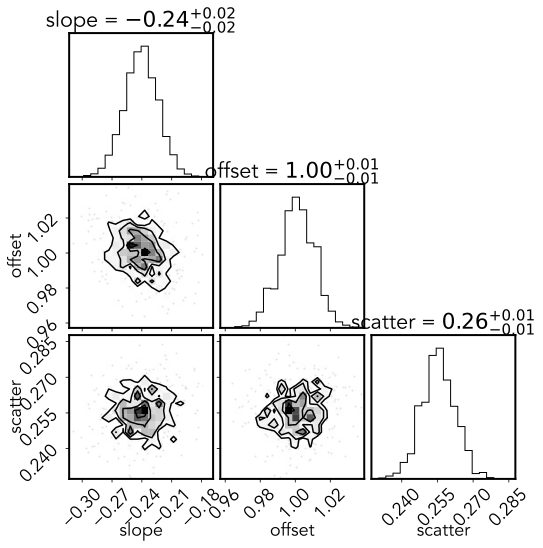

In [36]:
from ultranest.plot import cornerplot
cornerplot(sampler_RL.results)